### Step 1: Load and Understand Your Data

This project focuses on developing a tool that predicts apartment purchase prices in Poland using a XGB Regressor. If you're planning to sell your property and are unsure about its market value, this model can provide an estimated price based on key factors. It’s also a helpful resource for buyers, offering insights into typical property prices across different areas.

### Data Fields

- **price**: Property sale price in PLN.  
- **city**: Name of the property's city.  
- **latitude, longitude**: Property's geographic coordinates.  
- **squareMeters**: Apartment size in m².  
- **rooms**: Number of rooms.  
- **floor / floorCount**: Apartment’s floor and total building floors.  
- **buildYear**: Year of construction.  
- **condition**: Property state (new, renovated, needs repairs).  
- **type**: Property type (apartment, house, etc.).  
- **ownership**: Type of ownership.  
- **centreDistance**: Distance to city center (km).  
- **poiCount**: Number of nearby amenities (schools, clinics, etc.).  
- **[poiName]Distance**: Distance to the nearest amenity.  
- **has[features]**: Features like parking, balcony, elevator, security.  



In [87]:
import pandas as pd
import glob
import os

In [495]:
# Folder path with CSV files
folder_path = r"C:\Users\pmiro\Documents\EasyAnalizy\Flats\Flats"

# Import CSV files
csv_files = glob.glob(os.path.join(folder_path, "*.csv"))

# Appending files to the one DataFrame
df_list = [pd.read_csv(file) for file in csv_files]
df = pd.concat(df_list, ignore_index=True)

In [848]:
df_list = []
for file in csv_files:
    temp_df = pd.read_csv(file)
    
    # Import CSV files name and extension
    filename = os.path.basename(file)
    name_without_ext = os.path.splitext(filename)[0]

    # Extracting year, month from the file name
    year, month = name_without_ext.split("_")[-2:]
    
    # Adding new columns
    temp_df["Year"] = year
    temp_df["Month"] = month
    
    df_list.append(temp_df)

df = pd.concat(df_list, ignore_index=True)

In [849]:
# Display basic information
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 174067 entries, 0 to 174066
Data columns (total 30 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    174067 non-null  object 
 1   city                  174067 non-null  object 
 2   type                  136203 non-null  object 
 3   squareMeters          174067 non-null  float64
 4   rooms                 174067 non-null  float64
 5   floor                 143046 non-null  float64
 6   floorCount            171893 non-null  float64
 7   buildYear             145231 non-null  float64
 8   latitude              174067 non-null  float64
 9   longitude             174067 non-null  float64
 10  centreDistance        174067 non-null  float64
 11  poiCount              174067 non-null  float64
 12  schoolDistance        173910 non-null  float64
 13  clinicDistance        173402 non-null  float64
 14  postOfficeDistance    173839 non-null  float64
 15  

In [852]:
# Removing not interesting columns
df = df.drop(columns=["condition", "buildingMaterial"])

In [854]:
import plotly.express as px

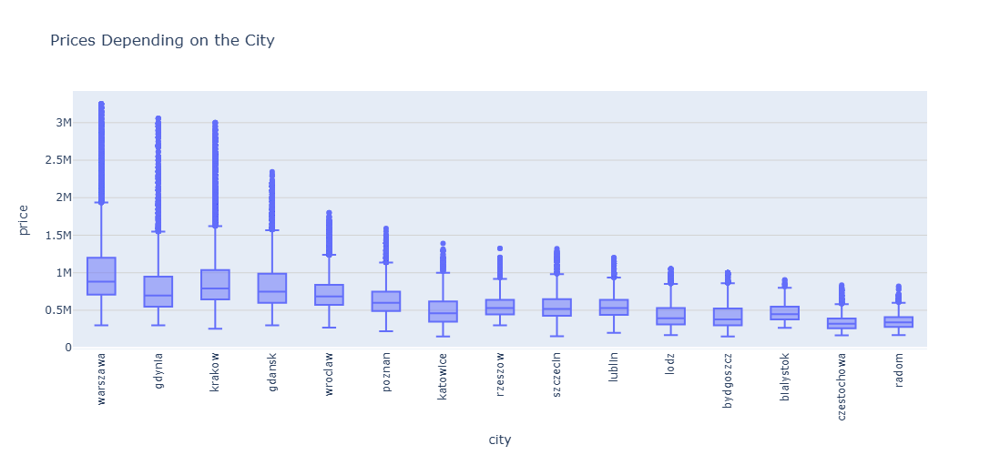

In [856]:
# Load data
df_sorted = df.sort_values(by='price', ascending=False)

# Creation of box plot
fig = px.box(
    df_sorted, 
    x='city', 
    y='price', 
    title='Prices Depending on the City'
)

fig.update_layout(
    xaxis_tickangle=-90,
    yaxis_gridcolor='lightgray'
)
# Change Size
fig.update_layout(
    width=1000,  # Szerokość mapy
    height=500,  # Wysokość mapy
)

fig.show()

C:\Users\pmiro\AppData\Local\Temp\ipykernel_6908\1928652999.py:15: DeprecationWarning:

*scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



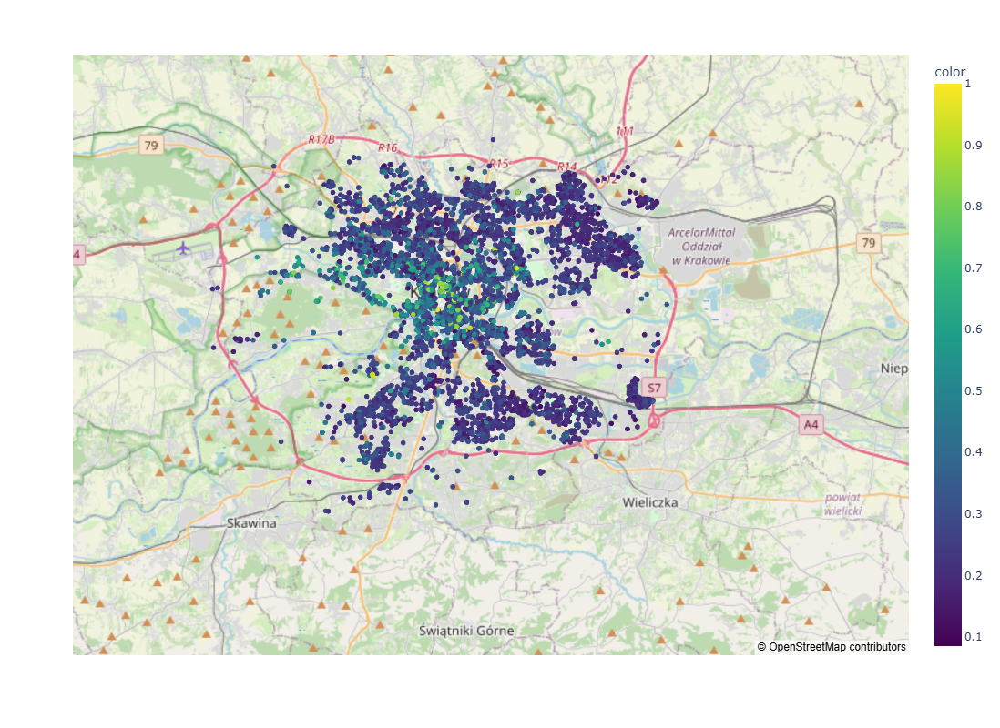

In [857]:
import plotly.express as px
import seaborn as sns
import numpy as np

# Filter for Krakow
df_krakow = df[df['city'].str.lower() == 'krakow'].copy()

# Creation of the color schema for price
df_krakow['color'] = df_krakow['price'] / df_krakow['price'].max()

# Plotly
colorscale = 'viridis'

# Map creation
fig = px.scatter_mapbox(df_krakow, lat='latitude', lon='longitude', hover_name='city',
                         hover_data=['price', 'squareMeters', 'rooms'],
                         color=df_krakow['color'], color_continuous_scale=colorscale, zoom=12)

# Style
fig.update_layout(mapbox_style='open-street-map')

# Size
fig.update_layout(
    width=1000,  # Szerokość mapy
    height=800,  # Wysokość mapy
)

# Result
fig.show()




### Visualize Distributions

Visualizing distributions helps to understand data spread, reveal patterns, detect outliers, and support the selection of appropriate statistical methods

In [861]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

In [863]:
# Selecting continuous variables 
continuous_vars =  ['squareMeters', 'rooms', 'floor', 'floorCount',
       'buildYear', 'latitude', 'longitude', 'centreDistance', 'poiCount',
       'schoolDistance', 'clinicDistance', 'postOfficeDistance',
       'kindergartenDistance', 'restaurantDistance', 'collegeDistance',
       'pharmacyDistance',  'price']

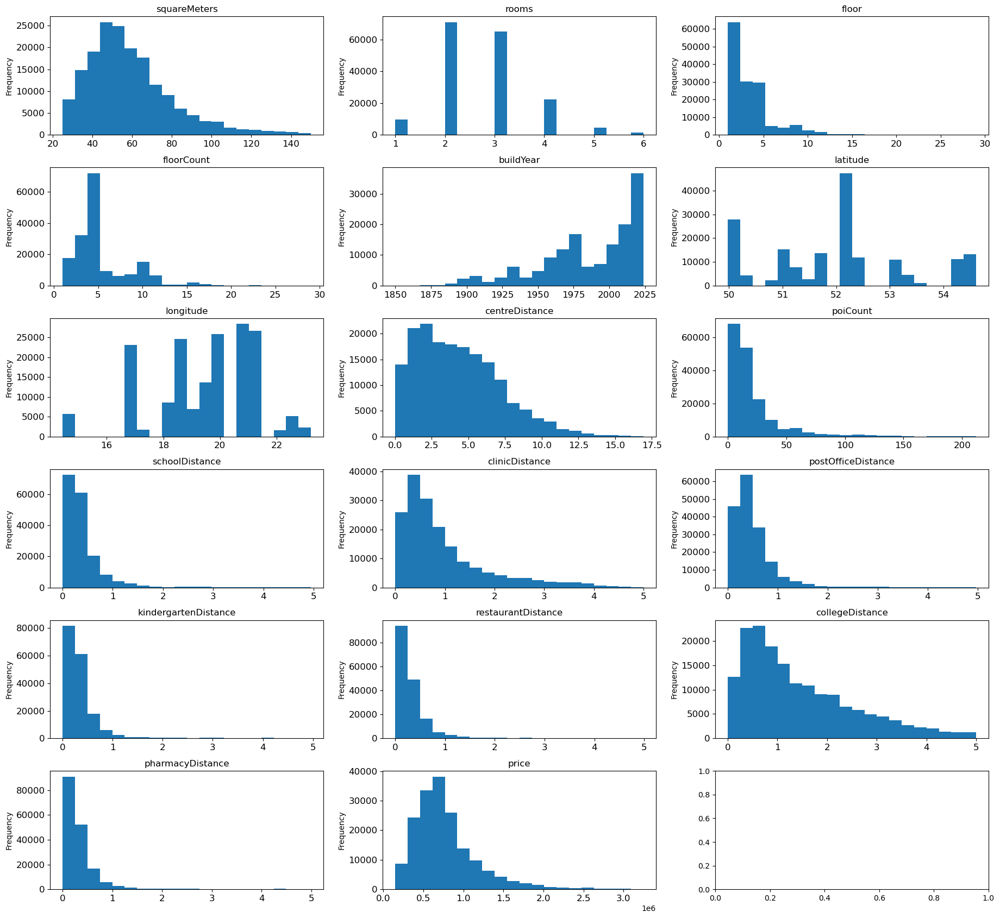

In [865]:
fig, axes = plt.subplots(6,3)

for i, el in enumerate(continuous_vars):
    ax = axes.flatten()[i]  
    df[el].plot(kind='hist', bins=20, ax=ax, fontsize='large') 
    ax.set_title(el)  

fig.set_size_inches(18.5, 17)
plt.tight_layout()

plt.show()

Observation:
Most variables are right-skewed.

Explanation:
This may result from the natural distribution of the data, where low values are frequent and high values are rare but extreme. Such skewness is common in measurements like concentrations or counts.

### Checking Outliers with a Boxplot

Identifying outliers in housing prices helps reveal potential data entry errors, extreme market cases, or unusual property characteristics that could distort analysis or model performance.

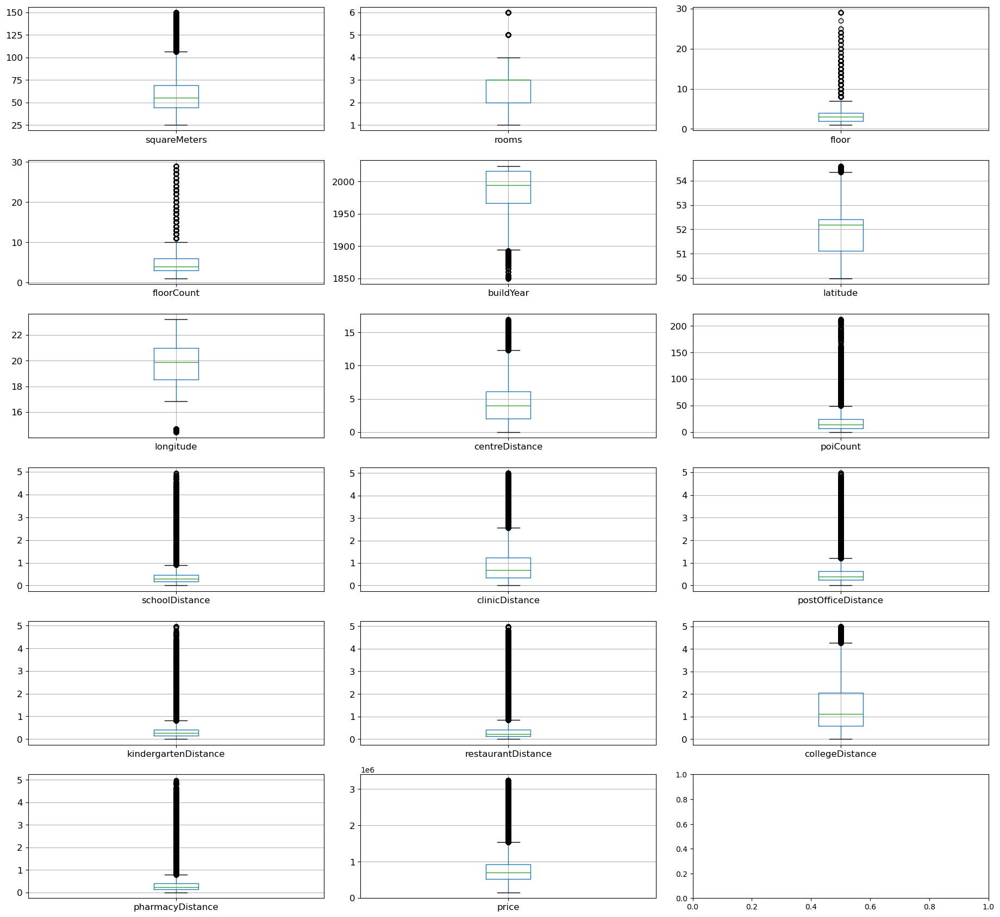

In [867]:
fig, axes = plt.subplots(6,3) # create figure and axes

for i, el in enumerate(list(df[continuous_vars].columns.values)):
      a = df.boxplot(el, ax=axes.flatten()[i], fontsize='large')

fig.set_size_inches(18.5, 17)
plt.tight_layout() 

plt.show()

### Remove Outliers Price

In order to model only standard apartment prices, outlier observations—specifically high-priced apartments—are removed.

In [869]:
# Define outlier based on IQR
Q1 = df['price'].quantile(0.25)
Q3 = df['price'].quantile(0.75)
IQR = Q3 - Q1

# Define range
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter out outliers
df_cleaned = df[(df['price'] >= lower_bound) & (df['price'] <= upper_bound)]

# Check deleted records
print(f"Number of removed outliers: {len(df) - len(df_cleaned)}")

# Saving if needed
#df_cleaned.to_csv("dane_mieszkan_cleaned.csv", index=False)

Liczba usuniętych wartości odstających: 9497


In [870]:
# Define outlier based on IQR
Q1 = df_cleaned['squareMeters'].quantile(0.25)
Q3 = df_cleaned['squareMeters'].quantile(0.75)
IQR = Q3 - Q1

# Define range
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter out outliers
df_squared_cleaned = df_cleaned[(df_cleaned['squareMeters'] >= lower_bound) & (df_cleaned['squareMeters'] <= upper_bound)]

# Check deleted records
print(f"Number of removed outliers: {len(df_cleaned) - len(df_squared_cleaned)}")

Liczba usuniętych wartości odstających: 5253


In [872]:
# Defining the variables included in the model
df_final=df_squared_cleaned[['city', 'squareMeters', 'rooms', 'buildYear', 'collegeDistance', 'centreDistance', 'floorCount','poiCount', 'hasElevator','price']]

In [873]:
# Removing NAs
df_final=df_final.dropna()

In [874]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
Index: 122873 entries, 5 to 174066
Data columns (total 10 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   city             122873 non-null  object 
 1   squareMeters     122873 non-null  float64
 2   rooms            122873 non-null  float64
 3   buildYear        122873 non-null  float64
 4   collegeDistance  122873 non-null  float64
 5   centreDistance   122873 non-null  float64
 6   floorCount       122873 non-null  float64
 7   poiCount         122873 non-null  float64
 8   hasElevator      122873 non-null  object 
 9   price            122873 non-null  int64  
dtypes: float64(7), int64(1), object(2)
memory usage: 10.3+ MB


### Feature engineering and Encoding

New variables are created to enhance model performance, and categorical features are encoded to make them suitable for machine learning algorithms.

In [875]:
# One-Hot Encoding (for many categories)
df_final = pd.get_dummies(df_final, columns=['hasElevator'])

In [876]:
df_final['age_of_building']=2025-df_final['buildYear']

In [129]:
#df_final['price_per_m2'] = df_final['price'] / df_final['squareMeters']

In [885]:
df_final=df_final.drop(['hasElevator_no'], axis=1)

In [887]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()

In [889]:
# Convert 'city' to no.
df_final['city_encoded'] = le.fit_transform(df_final['city'])

# Result
df_final[['city', 'city_encoded']].value_counts()

city         city_encoded
warszawa     13              38352
krakow       6               19357
wroclaw      14              14385
gdansk       3               12894
lodz         7                8324
bydgoszcz    1                5095
gdynia       4                4517
lublin       8                4206
poznan       9                4185
szczecin     12               3494
katowice     5                2197
radom        10               2140
bialystok    0                1825
rzeszow      11               1235
czestochowa  2                 667
Name: count, dtype: int64

In [891]:
df_final=df_final.drop(['city'], axis=1)

In [893]:
df_final.hasElevator_yes.value_counts()

hasElevator_yes
True     63977
False    58896
Name: count, dtype: int64

In [895]:
df_final['hasElevator_yes'] = df_final['hasElevator_yes'].map({True: 1, False: 0})

In [897]:
#scaler= StandardScaler()
#X_train, y_train= train_data.drop(['price'], axis=1), train_data['price']
#X_train_s=scaler.fit_transform(X_train)

In [899]:
# Log transform
df_final['log_price'] = np.log(df_final['price'])

In [901]:
# Removing not interesting columns
df_final = df_final.drop(columns=['buildYear'])

<Axes: >

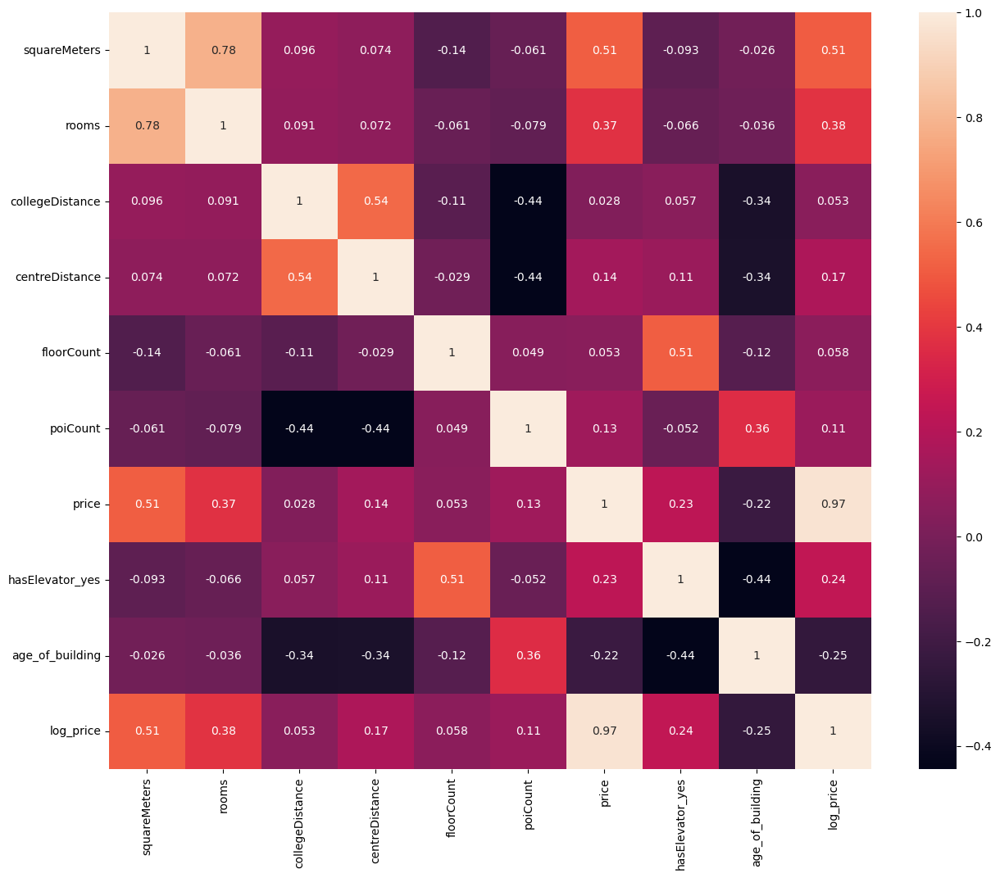

In [903]:
# Filter only numeric columns from the DataFrame
numeric_df_final = df_final.select_dtypes(include=['float64', 'int64'])

plt.figure(figsize=(15, 12))
sns.heatmap(numeric_df_final.corr(), annot=True)

### Start building data to train model

In [908]:
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score
import pickle
import joblib

In [910]:
from sklearn.model_selection import train_test_split

# The dataset is split into Y (the dependent variable) and X (the independent variables)
X = df_final.drop(['price', 'log_price'], axis=1)
y = df_final['price']

In [912]:
# The dataset is split into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [914]:
train_data = X_train.join(y_train)

In [916]:
scaler= StandardScaler()
X_train, y_train= train_data.drop(['price'], axis=1), train_data['price']
X_train_s=scaler.fit_transform(X_train)

### Linear Regression

A basic linear regression model is created as the starting point.

In [918]:
reg=LinearRegression()
reg.fit(X_train_s, y_train)

LinearRegression()

In [920]:
test_data = X_test.join(y_test)

In [922]:
X_test_s=scaler.fit_transform(X_test)

In [924]:
# Save model
with open('reg_linear_model.pkl', 'wb') as f:
    pickle.dump(reg, f)

In [926]:
# Save
joblib.dump(scaler, 'reg_scaler.pkl')

['reg_scaler.pkl']

### Final result of Linear Regression

In [929]:
reg.score(X_test_s,y_test)

0.45189684650525075

The prediction result of 0.4519 indicates a relatively low performance of the model. 

This suggests that the model is not capturing the relationship between the features and the target variable effectively. 

A result close to 0.5 typically points to a model that is performing at random, meaning it isn't providing much predictive value. 

Further tuning, feature engineering, or trying more advanced models might be necessary to improve the prediction accuracy.

In [931]:
y_train_pred = reg.predict(X_train_s)
y_test_pred = reg.predict(X_test_s)

In [933]:
r2_ln_train = r2_score(y_train, y_train_pred)
r2_ln_test = r2_score(y_test, y_test_pred)

In [935]:
print(f"R²  on the training set: {r2_ln_train:.4f}")
print(f"R²  on the testing set: {r2_ln_test:.4f}")

R² na zbiorze treningowym: 0.4538
R² na zbiorze testowym: 0.4519


In [937]:
from sklearn.model_selection import cross_val_score

cv_scores = cross_val_score(reg, X_train_s,y_train, cv=5, scoring='r2')

print(f"Average R² from cross-validation: {cv_scores.mean():.4f}")
print(f"Standard deviation R²: {cv_scores.std():.4f}")

Średnie R² z walidacji krzyżowej: 0.4536
Odchylenie standardowe R²: 0.0060


In [939]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

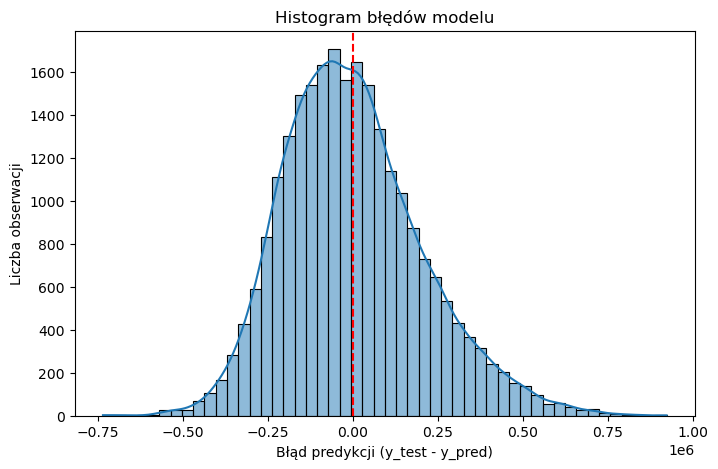

In [941]:
y_pred = reg.predict(X_test_s)
errors = y_test - y_pred

plt.figure(figsize=(8,5))
sns.histplot(errors, bins=50, kde=True)
plt.axvline(x=0, color='red', linestyle='--')
plt.xlabel("Prediction Error (y_test - y_pred)")
plt.ylabel("Number of Observations")
plt.title("Model Error Histogram")
plt.show()

The histogram of prediction errors shows the distribution of differences between actual and predicted values. 

It helps assess model accuracy by revealing bias, outliers, and overall performance. A symmetrical distribution around 0 indicates good model fit, while deviations suggest areas for improvement.

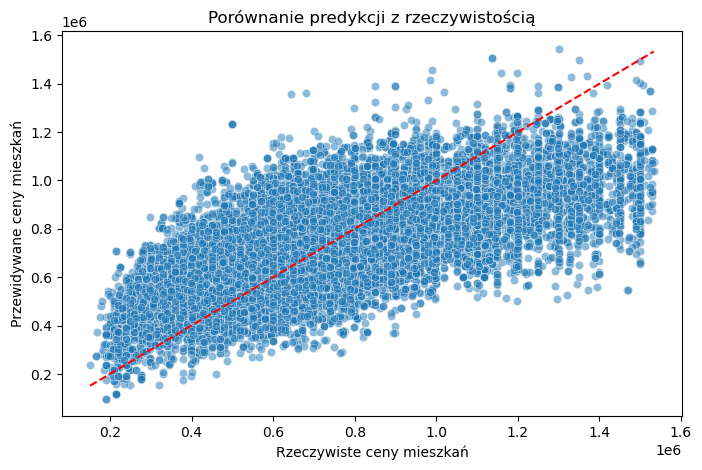

In [943]:
plt.figure(figsize=(8,5))
sns.scatterplot(x=y_test, y=y_pred, alpha=0.5)
plt.xlabel("Actual Apartment Prices")
plt.ylabel("Predicted Apartment Prices")
plt.title("Comparison of Predictions vs. Actual Values")
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color="red", linestyle="--")  # Linia idealnego dopasowania
plt.show()

In [945]:
from statsmodels.stats.diagnostic import het_goldfeldquandt

In [947]:
gq_test_stat, gq_p_value, _ = het_goldfeldquandt(errors, X_test_s)
print(f"Goldfeld-Quandt test stat: {gq_test_stat}, p-value: {gq_p_value}")

Goldfeld-Quandt test stat: 0.9621941150682745, p-value: 0.9836242172795665


### Interpretation:  
- **Null Hypothesis (H₀):** No heteroskedasticity (residual variance is constant).  
- **Alternative Hypothesis (H₁):** Presence of heteroskedasticity (residual variance is not constant).  

Since the p-value is 0.1177, which is greater than 0.05, we do not have enough evidence to reject the null hypothesis. This means that at a 5% significance level, we cannot conclude that heteroskedasticity is present in the model.  

### What does this mean for the model?  
The absence of significant heteroskedasticity indicates that the residual variance is stable, which is a positive sign. This suggests that the model meets one of the key assumptions of classical linear regression, ensuring reliable coefficient estimates and valid statistical tests.  

### Conclusion  
The results of the Goldfeld-Quandt test suggest that heteroskedasticity is not an issue in the model, which is beneficial for its overall quality.  


### Test

In [950]:
import pickle
import numpy as np
import pandas as pd
import joblib

# Upload model
with open('reg_linear_model.pkl', 'rb') as f:
    model = pickle.load(f)
    
# Load scaler (if you used StandardScaler)
scaler = joblib.load('reg_scaler.pkl')

In [952]:
# Map for city_encoded
city_mapping = {
    'warszawa': 13,
    'krakow': 6,
    'wroclaw': 14,
    'gdansk': 3,
    'lodz': 7,
    'bydgoszcz': 1,
    'gdynia': 4,
    'lublin': 8,
    'poznan': 9,
    'szczecin': 12,
    'katowice': 5,
    'radom': 10,
    'bialystok': 0,
    'rzeszow': 11,
    'czestochowa': 2
}

In [954]:
# Sample data for test
common_data = {
    'squareMeters': 60,       
    'rooms': 3,               
    'collegeDistance': 2.5,   
    'centreDistance': 3.0,    
    'floorCount': 10,         
    'poiCount': 20,           
    'hasElevator_yes': 1,     
    'age_of_building': 10    

}

# Data Frame creation
cities = list(city_mapping.keys())
X_new = pd.DataFrame({
    'city_encoded': [city_mapping[city] for city in cities],
    'squareMeters': [common_data['squareMeters']] * len(cities),
    'rooms': [common_data['rooms']] * len(cities),
    'collegeDistance': [common_data['collegeDistance']] * len(cities),
    'centreDistance': [common_data['centreDistance']] * len(cities),
    'floorCount': [common_data['floorCount']] * len(cities),
    'poiCount': [common_data['poiCount']] * len(cities),
    'hasElevator_yes': [common_data['hasElevator_yes']] * len(cities),
    'age_of_building': [common_data['age_of_building']] * len(cities)
})

In [959]:
# New scaled data
X_new_scaled = scaler.transform(X_new)

# Predicted price
predicted_price_scaled = model.predict(X_new_scaled)

C:\Users\pmiro\anaconda3\envs\new_env\lib\site-packages\sklearn\base.py:493: FutureWarning:

The feature names should match those that were passed during fit. Starting version 1.2, an error will be raised.
Feature names must be in the same order as they were in fit.




In [965]:
# Adding predicted_price to dataframe
X_new['predicted_price'] = predicted_price_scaled

pd.set_option('display.float_format', '{:.2f}'.format)

# Df table creation
result_df = pd.DataFrame([X_new['predicted_price'].values], columns=cities)

# Result
result_df

,warszawa,krakow,wroclaw,gdansk,lodz,bydgoszcz,gdynia,lublin,poznan,szczecin,katowice,radom,bialystok,rzeszow,czestochowa
0,1405520.06,1335319.60,1415548.70,1305233.69,1345348.24,1285176.42,1315262.33,1355376.88,1365405.51,1395491.42,1325290.97,1375434.15,1275147.78,1385462.79,1295205.06


### Lasso

In [192]:
lasso=Lasso(alpha=0.01)
lasso.fit(X_train_s, y_train)

Lasso(alpha=0.01)

In [194]:
lasso.score(X_test_s,y_test)

0.9446467458703965

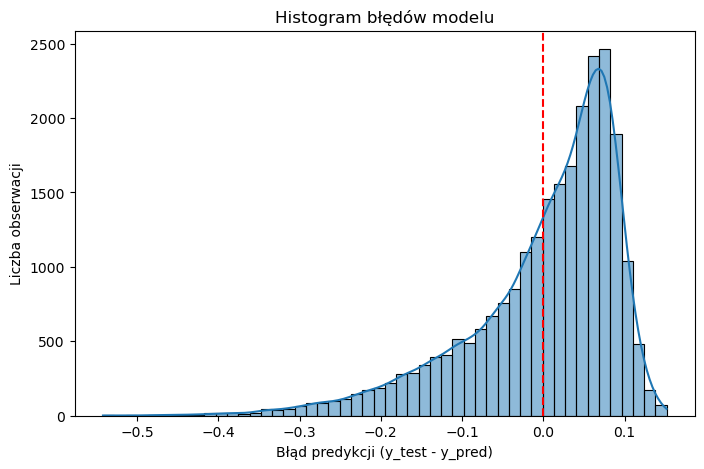

In [196]:
y_pred = lasso.predict(X_test_s)
errors = y_test - y_pred

plt.figure(figsize=(8,5))
sns.histplot(errors, bins=50, kde=True)
plt.axvline(x=0, color='red', linestyle='--')
plt.xlabel("Prediction Error (y_test - y_pred)")
plt.ylabel("Number of Observations")
plt.title("Model Error Histogram")
plt.show()

The histogram is left-skewed, meaning the model tends to overestimate apartment prices.

Most errors are positive (actual prices are lower than predicted), and the long tail on the left indicates some large overestimations. 

This suggests that the model may be biased toward predicting higher prices than reality, which could be corrected by improving feature selection, applying transformations, or adjusting the model's complexity

In [18]:
plt.figure(figsize=(8,5))
sns.scatterplot(x=y_test, y=y_pred, alpha=0.5)
plt.xlabel("Actual Apartment Prices")
plt.ylabel("Predicted Apartment Prices")
plt.title("Comparison of Predictions with Actual Values")
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color="red", linestyle="--") 
plt.show()

NameError: name 'plt' is not defined

In [224]:
from xgboost import XGBRegressor

### XGBRegressor

In [1006]:
from sklearn.model_selection import GridSearchCV
from xgboost import XGBRegressor

In [1111]:
xgb = XGBRegressor(
    n_estimators=200,         # Setting the number of trees
    learning_rate=0.1,        # Learning rate
    max_depth=10,             # Maximum tree depth
    colsample_bytree=1.0,     # Use all features for each tree
    subsample=0.8             # Use 80% of the training data per tree
)

xgb.fit(X_train, y_train)

print(f"XGBoost R^2: {xgb.score(X_test, y_test)}")

XGBoost R^2: 0.9343188952022884


In [1043]:
# Model
xgb = XGBRegressor()

# Defining the hyperparameter search space
param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [3, 6, 10],
    'subsample': [0.8, 0.9, 1.0],
    'colsample_bytree': [0.8, 0.9, 1.0]
}

In [1045]:
# Creation of GridSearchCV
grid_search = GridSearchCV(estimator=xgb, param_grid=param_grid, scoring='neg_mean_squared_error', cv=5, verbose=1, n_jobs=-1)

# Fit model
grid_search.fit(X_train, y_train)

# Result
print("Best parameters:", grid_search.best_params_)
print("Best results:", grid_search.best_score_)

# Best model
best_model = grid_search.best_estimator_


Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Najlepsze parametry: {'colsample_bytree': 1.0, 'learning_rate': 0.1, 'max_depth': 10, 'n_estimators': 200, 'subsample': 0.8}
Najlepszy wynik: -5446697993.287909


In [1113]:
# Save model XGBoost
with open('xgb_model_new.pkl', 'wb') as f:
    pickle.dump(xgb, f)

In [1115]:
xgb.feature_names_in_

array(['squareMeters', 'rooms', 'collegeDistance', 'centreDistance',
       'floorCount', 'poiCount', 'hasElevator_yes', 'age_of_building',
       'city_encoded'], dtype='<U15')

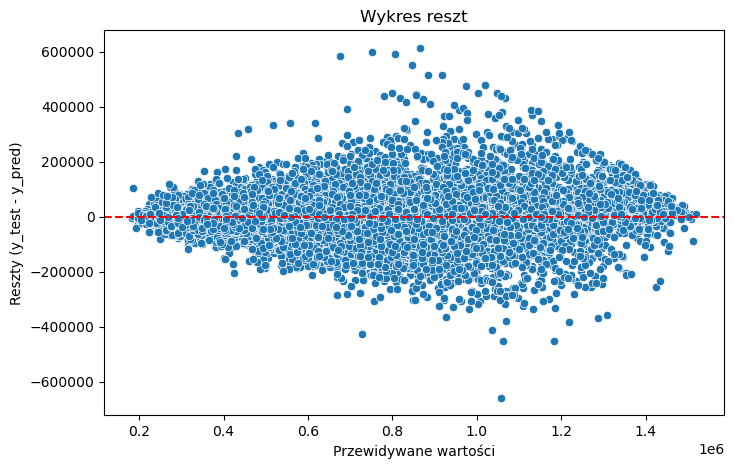

In [1051]:
y_pred = xgb.predict(X_test)
residuals = y_test - y_pred

plt.figure(figsize=(8, 5))
sns.scatterplot(x=y_pred, y=residuals)
plt.axhline(y=0, color='r', linestyle='--')
plt.xlabel("Predicted")
plt.ylabel("Residuals (y_test - y_pred)")
plt.title("Residuals")
plt.show()

A correct residuals plot should show points randomly scattered around zero, with no visible pattern or trend. This indicates that the model makes unbiased predictions and captures the data well.

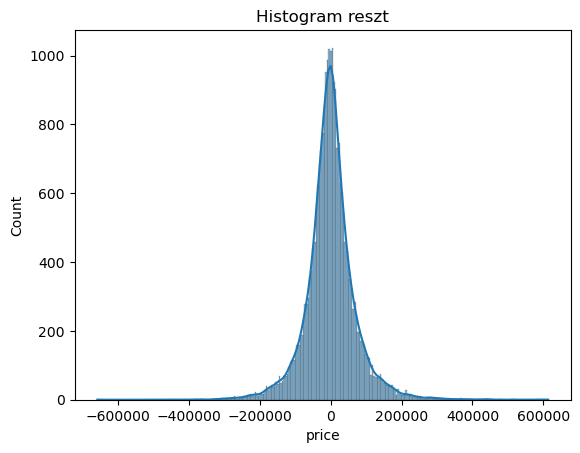

In [1053]:
sns.histplot(residuals, kde=True)
plt.title("Residuals Histogram")
plt.show()

In [1055]:
from statsmodels.stats.diagnostic import het_breuschpagan
import statsmodels.api as sm

In [1057]:
X_test_const = sm.add_constant(X_test)  # Dodaj stałą do modelu
bp_test = het_breuschpagan(residuals, X_test_const)

print(f"Stat test BP: {bp_test[0]}, P-wartość: {bp_test[1]}")

Statystyka testu BP: 301.07599817688424, P-wartość: 1.5432707569740693e-59


In [1059]:
gq_test_stat, gq_p_value, _ = het_goldfeldquandt(residuals, X_test)
print(f"Goldfeld-Quandt test stat: {gq_test_stat}, p-value: {gq_p_value}")

Goldfeld-Quandt test stat: 0.949191723981039, p-value: 0.9980664187441687


Interpretation:

The Goldfeld-Quandt test statistic is 0.949 with a p-value of 0.9981, which is very high. This suggests no evidence of heteroscedasticity. The high p-value indicates that we fail to reject the null hypothesis, meaning the residuals' variance appears to be constant, and the model does not show signs of heteroscedasticity based on this test.

In [1062]:
from sklearn.metrics import mean_absolute_error, mean_squared_error

In [1064]:
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = mse ** 0.5

print(f"MAE: {mae}")
print(f"MSE: {mse}")
print(f"RMSE: {rmse}")

MAE: 48764.49251017294
MSE: 5047708026.341839
RMSE: 71047.22391720762


In [1033]:
y_train_pred = xgb.predict(X_train)
y_test_pred = xgb.predict(X_test)

r2_train = r2_score(y_train, y_train_pred)
r2_test = r2_score(y_test, y_test_pred)

print(f"R² for train: {r2_train}")
print(f"R² for test: {r2_test}")

R² na train: 0.8523383270829329
R² na test: 0.8459961304102457


In [1035]:
df_results = pd.DataFrame({"Actual": y_test, "Predicted": y_test_pred})
df_results["Error"] = df_results["Actual"] - df_results["Predicted"]

# Check the errors for the most expensive apartments (e.g., top 10%)
top_10_percent = df_results["Actual"].quantile(0.90)
df_high_price = df_results[df_results["Actual"] >= top_10_percent]

print(df_high_price.describe())

          Actual  Predicted      Error
count    2463.00    2463.00    2463.00
mean  1295025.77 1154665.12  140360.62
std    110189.96  129567.43  132901.47
min   1139000.00  642412.25 -234595.38
25%   1199999.00 1072022.50   46571.56
50%   1289915.00 1166185.75  130932.50
75%   1380000.00 1250079.88  219658.44
max   1533200.00 1475993.88  718027.94


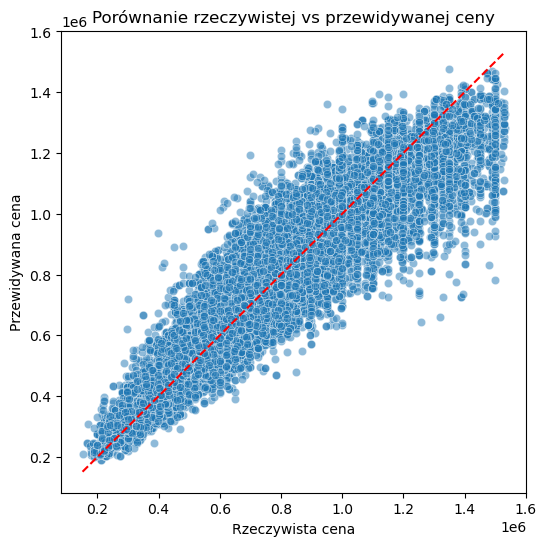

In [1037]:
plt.figure(figsize=(6,6))
sns.scatterplot(x=df_results["Actual"], y=df_results["Predicted"], alpha=0.5)
plt.plot([df_results["Actual"].min(), df_results["Actual"].max()], 
         [df_results["Actual"].min(), df_results["Actual"].max()], 
         color='r', linestyle='--')  # Linia idealnego dopasowania
plt.xlabel("Actual Price")
plt.ylabel("Predicted Price")
plt.title("Comparison of Actual vs. Predicted Price")
plt.show()

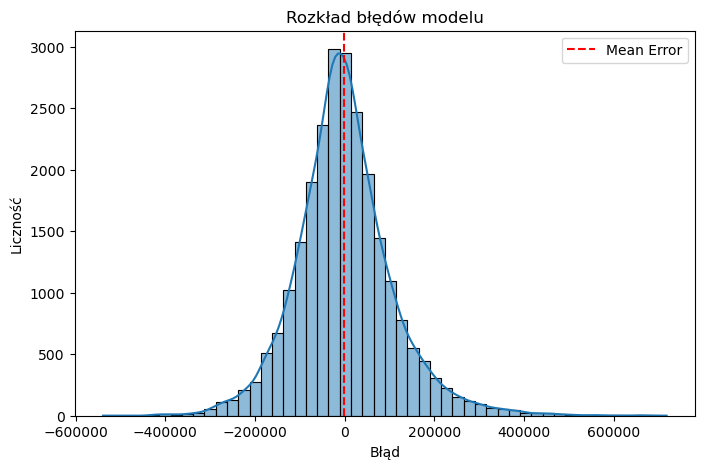

In [1039]:
plt.figure(figsize=(8,5))
sns.histplot(df_results["Error"], bins=50, kde=True)
plt.axvline(df_results["Error"].mean(), color='red', linestyle="--", label="Mean Error")
plt.xlabel("Error")
plt.ylabel("Frequency")
plt.title("Model Error Distribution")
plt.legend()
plt.show()

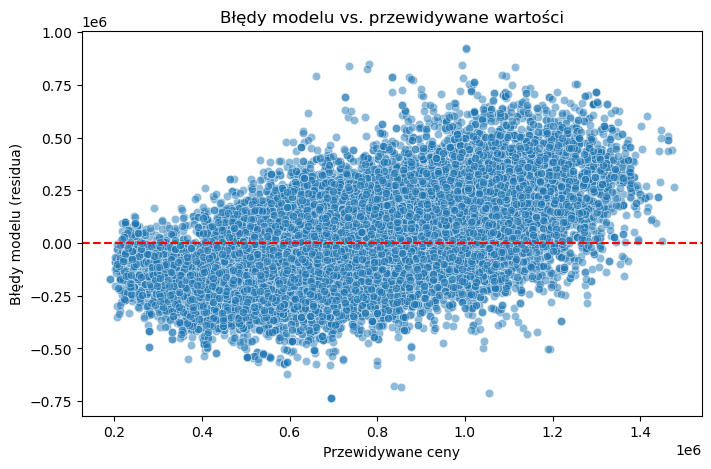

In [1041]:
plt.figure(figsize=(8, 5))
sns.scatterplot(x=df_results["Predicted"], y=errors, alpha=0.5)
plt.axhline(0, color="red", linestyle="--")
plt.xlabel("Predicted Prices")
plt.ylabel("Model Errors (Residuals)")
plt.title("Model Errors vs. Predicted Values")
plt.show()

In [1068]:
from sklearn.inspection import permutation_importance
result = permutation_importance(xgb, X_test, y_test, n_repeats=10, random_state=42)
importance_df = pd.DataFrame(result.importances_mean, index=X_test.columns, columns=["Importance"])
importance_df.sort_values(by="Importance", ascending=False, inplace=True)
print(importance_df)

                 Importance
city_encoded           0.89
squareMeters           0.76
age_of_building        0.27
centreDistance         0.15
poiCount               0.07
collegeDistance        0.07
floorCount             0.02
hasElevator_yes        0.02
rooms                  0.01


In [1105]:
# Preparing input variables - assume you have data about cities
# The 'city_encoded' variable represents encoded cities (e.g., numbers from 0 to 14)
cities = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]  # List of city codes
# Assume the variables are the same for each city (example values)
fixed_values = {
    'squareMeters': 30,  # e.g., apartment size in square meters
    'rooms': 1,          # number of rooms
    'collegeDistance': 2, # distance to university in km
    'centreDistance': 10,  # distance to city center in km
    'floorCount': 2,     # number of floors in the building
    'poiCount': 3,       # number of points of interest
    'hasElevator_yes': 1, # apartment has an elevator
    'age_of_building': 4 # age of the building
}


In [1107]:
# Creating a DataFrame where only 'city_encoded' changes for each city
predictions = []
for city in cities:
    # Creating a dictionary with data for this city
    input_data = fixed_values.copy()
    input_data['city_encoded'] = city  # Adding the encoded city
    # Creating a DataFrame with one observation
    X_new = pd.DataFrame([input_data])
    
    # Predicting the price using the model
    predicted_price = xgb.predict(X_new)  # XGBRegressor model
    predictions.append(predicted_price[0])

# Creating a DataFrame with the results
df_predictions = pd.DataFrame({
    'city_encoded': cities,
    'predicted_price': predictions
})

# Adding the city name using a mapping
city_mapping = {
    0: 'Białystok', 1: 'Bydgoszcz', 2: 'Częstochowa', 3: 'Gdańsk', 4: 'Gdynia',
    5: 'Katowice', 6: 'Kraków', 7: 'Łódź', 8: 'Lublin', 9: 'Poznań', 10: 'Radom',
    11: 'Rzeszów', 12: 'Szczecin', 13: 'Warszawa', 14: 'Wrocław'
}
df_predictions['city'] = df_predictions['city_encoded'].map(city_mapping)

# Formatting results (removing scientific notation)
df_predictions['predicted_price'] = df_predictions['predicted_price'].apply(lambda x: f'{x:,.2f}')

# Displaying the results
print(df_predictions)


    city_encoded predicted_price         city
0              0      444,251.78    Białystok
1              1      369,521.44    Bydgoszcz
2              2      380,545.94  Częstochowa
3              3      525,511.25       Gdańsk
4              4      532,099.88       Gdynia
5              5      400,056.09     Katowice
6              6      508,888.41       Kraków
7              7      343,042.81         Łódź
8              8      365,119.47       Lublin
9              9      375,722.00       Poznań
10            10      358,980.16        Radom
11            11      378,182.53      Rzeszów
12            12      382,768.38     Szczecin
13            13      537,737.88     Warszawa
14            14      451,735.06      Wrocław
